# Análise do CAR para o município de Rio Bonito do Iguaçú, PR, através de linguagem do Python.

INPE 2019/I

Trabalho realizado para a disciplina Introdução à Programação para Sensoriamento Remoto 

Integrantes: Gabriel Chagas, Gabriela Simóes e Marcus Silveira 

In [88]:
# importando as bibliotecas
from osgeo import gdal, gdalconst, osr, ogr
#from pyproj import Proj, transform
import geopandas as gpd
import matplotlib.pyplot as plt
import os
import numpy as np
from shapely.ops import cascaded_union
import pandas as pd
#import itertools

# Etapa 1 - Cálculo da área de vegetação nativa total (vegetação nativa do CAR + vegetação nativa da fundação)

In [89]:
os.chdir(r"C:\Users\chaga\OneDrive\Área de Trabalho\PG\APP")
os.listdir()

['APP.dbf',
 'APP.prj',
 'APP.shp',
 'APP.shp.MARCUS.19736.13760.sr.lock',
 'APP.shx',
 'APP.zip',
 'App_fund.cpg',
 'App_fund.dbf',
 'App_fund.shp',
 'App_fund.shx',
 'App_fund_clip.cpg',
 'App_fund_clip.dbf',
 'App_fund_clip.prj',
 'App_fund_clip.shp',
 'App_fund_clip.shx',
 'AREA_ALTITUDE_SUPERIOR_1800.dbf',
 'AREA_ALTITUDE_SUPERIOR_1800.zip',
 'AREA_CONSOLIDADA.dbf',
 'AREA_CONSOLIDADA.prj',
 'AREA_CONSOLIDADA.shp',
 'AREA_CONSOLIDADA.shp.MARCUS.19736.13760.sr.lock',
 'AREA_CONSOLIDADA.shx',
 'AREA_CONSOLIDADA.zip',
 'AREA_DECLIVIDADE_MAIOR_45.dbf',
 'AREA_DECLIVIDADE_MAIOR_45.prj',
 'AREA_DECLIVIDADE_MAIOR_45.shp',
 'AREA_DECLIVIDADE_MAIOR_45.shx',
 'AREA_DECLIVIDADE_MAIOR_45.zip',
 'AREA_IMOVEL.dbf',
 'AREA_IMOVEL.prj',
 'AREA_IMOVEL.shp',
 'AREA_IMOVEL.shp.MARCUS.19736.13760.sr.lock',
 'AREA_IMOVEL.shp.MARCUS.21252.21420.sr.lock',
 'AREA_IMOVEL.shx',
 'AREA_IMOVEL.zip',
 'AREA_POUSIO.dbf',
 'AREA_POUSIO.prj',
 'AREA_POUSIO.shp',
 'AREA_POUSIO.shp.MARCUS.19736.13760.sr.lock',
 'A

### Área do imóvel CAR

In [90]:
area_im = gpd.GeoDataFrame.from_file('AREA_IMOVEL.shp')
area_im_reproj = area_im.to_crs({'init' :'epsg:31982'})

In [91]:
#buffer
area_im_reproj['geometry'] = area_im_reproj.buffer(0.01)

In [92]:
#Obtendo o poligono da união dos imóveis pra ser usado como corte dos outros shapes
unionarea_im = area_im_reproj['geometry'].cascaded_union

In [93]:
#Transformando o polígono acima em geodataframe
unionarea_im_gdf = gpd.GeoDataFrame(gpd.GeoSeries(unionarea_im))
unionarea_im_gdf = unionarea_im_gdf.rename(columns={0:'geometry'}).set_geometry('geometry')
unionarea_im_gdf.head()

,geometry
0,(POLYGON ((354809.0925403422 7173072.943614426...


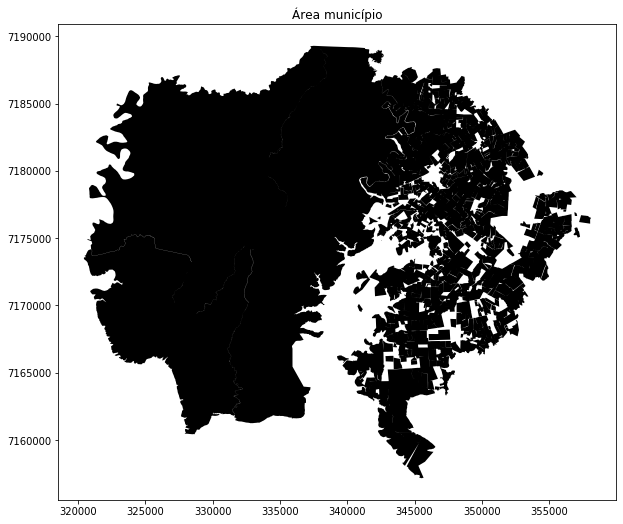

In [94]:
#Área usada para recorte
ax = unionarea_im_gdf.plot(cmap='gray',figsize=(10,15));
ax.set_title("Área município");

### Dados Fundação

In [95]:
#Fundação
#pegando as APP's de todos os municípios que abrangem nossa área
fund1 = gpd.GeoDataFrame.from_file('PR_4113304_APP.shp')
fund2 = gpd.GeoDataFrame.from_file('PR_4117057_APP.shp')
fund3 = gpd.GeoDataFrame.from_file('PR_4120150_APP.shp')
fund4 = gpd.GeoDataFrame.from_file('PR_4122156_APP.shp')
#pegando o uso do solo de todos os municípios:
uso1 = gpd.GeoDataFrame.from_file('PR_4113304_USO.shp')
uso2 = gpd.GeoDataFrame.from_file('PR_4117057_USO.shp')
uso3 = gpd.GeoDataFrame.from_file('PR_4120150_USO.shp')
uso4 = gpd.GeoDataFrame.from_file('PR_4122156_USO.shp')
#pegando os pontos das nascentes da fundação para todos os municípios:
nasc1 = gpd.GeoDataFrame.from_file('PR_4113304_NASCENTES.shp')
nasc2 = gpd.GeoDataFrame.from_file('PR_4117057_NASCENTES.shp')
nasc3 = gpd.GeoDataFrame.from_file('PR_4120150_NASCENTES.shp')
nasc4 = gpd.GeoDataFrame.from_file('PR_4122156_NASCENTES.shp')

In [96]:
#unindo APP's de todos os municípios no mesmo geodataframe
app_fund = gpd.GeoDataFrame(pd.concat([fund1, fund2, fund3, fund4]))

#unindo a vegetação nativa da fundação de todos os municípios no mesmo geodataframe
vg_fund = gpd.GeoDataFrame(pd.concat([uso1[3:5], uso2[3:5], uso3[3:5], uso4[3:5]]))

#unindo as nascentes de todos os municípios no mesmo geodataframe:
nasc_fund = gpd.GeoDataFrame(pd.concat([nasc1, nasc2, nasc3, nasc4]))

#Normalizando as projeções
nasc_fund.crs = {'init': 'epsg:31982'}
vg_fund.crs = {'init' :'epsg:31982'}

#Salvando em shape:
vg_fund.to_file('vg_fund.shp')
app_fund.to_file('App_fund.shp')
nasc_fund.to_file('nasc_fund.shp')

### Extração da Veg Nativa (Fundação)

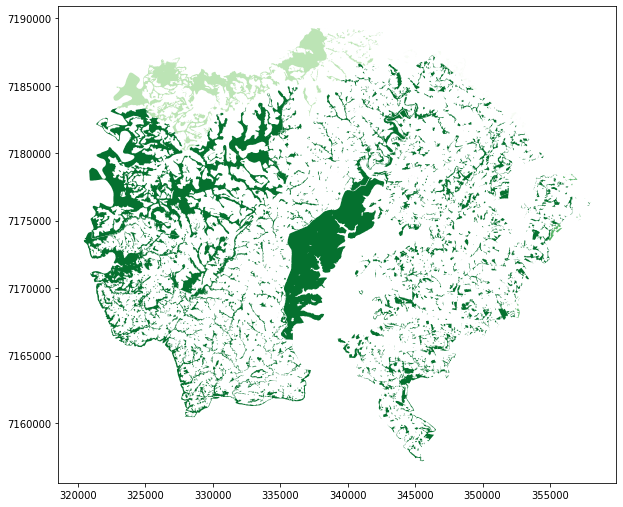

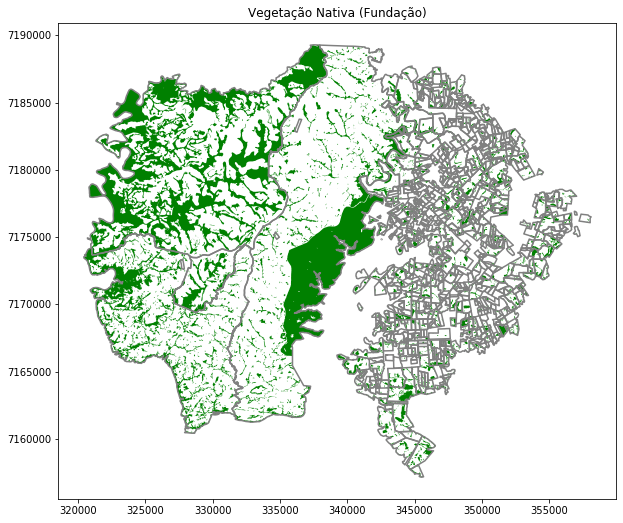

In [97]:
#Extraindo a veg nativa da fundação dentro da área dos imóveis
vgfund_clip = vg_fund['geometry'].intersection(unionarea_im)
ax2 = vgfund_clip.plot(cmap='Greens',figsize=(10,15));
im_overlap = area_im_reproj['geometry'].boundary
ax2 = vgfund_clip.plot(ax=im_overlap.plot(color='gray', figsize=(10, 10)), facecolor='green');
ax2.set_title("Vegetação Nativa (Fundação)");

In [98]:
#Transformando vgfund_clip em geodataframe para ser usada nas próximas análises
vgfund_clip_gdf = gpd.GeoDataFrame(gpd.GeoSeries(vgfund_clip))
vgfund_clip_gdf = vgfund_clip_gdf.rename(columns={0:'geometry'}).set_geometry('geometry')

In [99]:
#Projetando e salvando vgfund_clip_gdf em shapefile
vgfund_clip_gdf.crs = {'init' :'epsg:31982'}
vgfund_clip_gdf.crs
vgfund_clip_gdf.to_file('vgfund_clip.shp')

### Importando a Vegetação Nativa CAR

In [100]:
# Import it to a GeoDataFrame using geopandas
#Vegetação nativa do Car
vg_features = gpd.GeoDataFrame.from_file('VEGETACAO_NATIVA.shp')
# Check the first 5 entries
vg_features.head()

,IDF,NOM_TEMA,NUM_AREA,geometry
0,142860,Remanescente de VegetaÃ§Ã£o Nativa,14.374268,(POLYGON ((-52.42962598673139 -25.512917320845...
1,149030,Remanescente de VegetaÃ§Ã£o Nativa,0.183619,POLYGON ((-52.52533435821533 -25.6074364958182...
2,867089,Remanescente de VegetaÃ§Ã£o Nativa,1.438618,POLYGON ((-52.55951623286653 -25.5325664863190...
3,369594,Remanescente de VegetaÃ§Ã£o Nativa,3.595064,POLYGON ((-52.54898281206754 -25.5151272596397...
4,369597,Remanescente de VegetaÃ§Ã£o Nativa,2.692197,POLYGON ((-52.54129333981932 -25.5148808491456...


In [101]:
print(vg_features.crs)

{'init': 'epsg:4674'}


In [102]:
#Mudar as coordenadas da vegetação do CAR
vg_features_reproj = vg_features.to_crs({'init' :'epsg:31982'})
print(vg_features_reproj.crs)

{'init': 'epsg:31982'}


In [103]:
vg_features_reproj.head()

,IDF,NOM_TEMA,NUM_AREA,geometry
0,142860,Remanescente de VegetaÃ§Ã£o Nativa,14.374268,(POLYGON ((356332.0760759369 7177483.569973778...
1,149030,Remanescente de VegetaÃ§Ã£o Nativa,0.183619,"POLYGON ((346832.9063588048 7166907.59158786, ..."
2,867089,Remanescente de VegetaÃ§Ã£o Nativa,1.438618,"POLYGON ((343302.541914277 7175160.470414957, ..."
3,369594,Remanescente de VegetaÃ§Ã£o Nativa,3.595064,"POLYGON ((344338.5785874091 7177104.454909352,..."
4,369597,Remanescente de VegetaÃ§Ã£o Nativa,2.692197,"POLYGON ((345111.1162218368 7177140.727690453,..."


In [104]:
#Fazer o buffer para evitar erros nos próximos procedimentos
vg_features_reproj['geometry'] = vg_features_reproj.buffer(0.01)

In [105]:
#Para deixar os polígonos em uma linha (vegetação nativa do CAR)
vg_features_new = vg_features_reproj.dissolve(by='NOM_TEMA', aggfunc='sum')

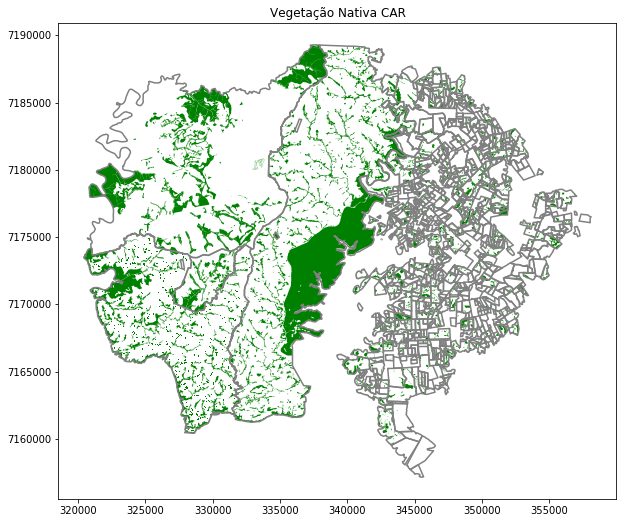

In [106]:
# Plotando a Veg Nativa CAR
ax = vg_features_new.plot(ax=im_overlap.plot(color='gray', figsize=(10, 10)), facecolor='green');
#ax = vg_features_new.plot(cmap='gray', figsize=(10,15));
ax.set_title("Vegetação Nativa CAR");

#### Veg Nativa Fundação - Processamento

In [107]:
vgfund_clip_gdf ['x'] = 1
vgfund_clip_gdf.head()

,geometry,x
3,"(POLYGON ((356564.0477999995 7178422.1926, 356...",1
4,(),1
3,(POLYGON ((327866.7766999998 7179833.682899999...,1
4,(),1
3,"(POLYGON ((349806.6559479096 7166301.10456567,...",1


In [108]:
#buffer
vgfund_clip_gdf['geometry'] = vgfund_clip_gdf.buffer(0.01)

In [109]:
#Para deixar os polígonos em uma linha (vegetação nativa da fundação)
vg_fund_total = vgfund_clip_gdf.dissolve(by='x', aggfunc='sum')

In [110]:
vg_fund_total

,geometry
x,
1,(POLYGON ((345427.3684822579 7157607.641004582...


### Unindo os dados de vegetação

In [111]:
#Para transformar o GeoDataFrame em lista
new_nat_CAR = [x for i, x in vg_features_new.iterrows()]

In [112]:
#Para transformar o GeoDataFrame em lista
new_nat_fund = [x for i, x in vg_fund_total.iterrows()]

In [113]:
#Para colocar todos os polígonos (geometry), de ambas as listas, em uma nova variável, deixando-as em uma única coluna e em uma única linha
new_veg_nat = [new_nat_CAR[0][0], new_nat_fund[0][0]]

In [114]:
#Para fazer a união dos polígonos, evitando, assim, a sobreposição
vg_nat = cascaded_union(new_veg_nat)

In [115]:
veg_nat_total = (vg_nat.area/10000)

In [116]:
print("Área total de Veg. nativa (ha): ", veg_nat_total)

Área total de Veg. nativa (ha):  20962.142164125304


In [117]:
#Para transformar em um GeoDataFrame
vg_nat_new = gpd.GeoDataFrame(gpd.GeoSeries(vg_nat))
#Segunda etapa para transformar para um GeoDataFrame, assim será possível plotar (mudar o nome da coluna)
vg_nat_new = vg_nat_new.rename(columns={0:'geometry'}).set_geometry('geometry')

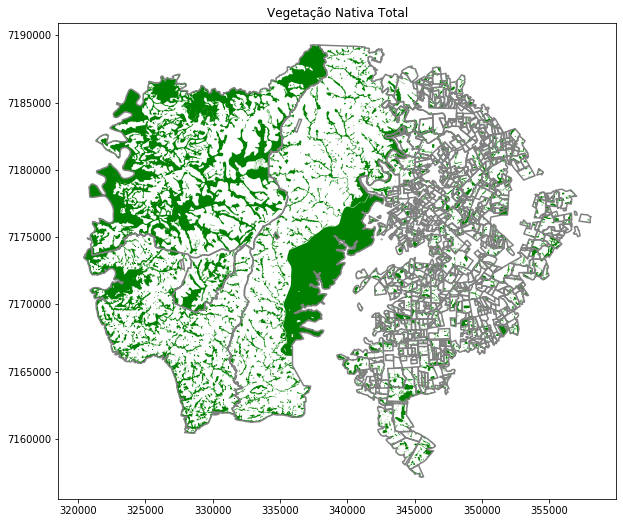

In [118]:
ax = vg_nat_new.plot(ax=im_overlap.plot(color='gray', figsize=(10, 10)), facecolor='green');

ax.set_title("Vegetação Nativa Total");
#vg_nat_new.plot();

In [119]:
#Para salvar como um .shp
vg_total_nat = vg_nat_new.to_file("vg_nat_total.shp")

# Etapa 2 - Verificação de inconsistências nos dados CAR

### Verificando as regiões de sobreposição dos imóveis

In [120]:
#Procedimento para a verificação de sobeposição dos imóveis:
im_overlap_union = area_im_reproj['geometry'].boundary.unary_union

In [121]:
#Área total dos imóveis (ha), com sopreposição inclusa:
area_im_overlap = sum(area_im_reproj['geometry'].area)
print("Área imóvel com sobreposição (ha): ",area_im_overlap/10000)

Área imóvel com sobreposição (ha):  64746.22842713061


In [122]:
#Área total que os imóveis abrangem
area_im_tot = sum(unionarea_im_gdf.area)
print("Área imóvel sem sobreposição (ha): ",area_im_tot/10000)

Área imóvel sem sobreposição (ha):  63594.30534108485


In [123]:
#Área total da sobreposição (ha):
sobr = area_im_overlap - (area_im_tot)
print("Área sobreposta(ha): ",sobr/10000)

Área sobreposta(ha):  1151.9230860457658


In [124]:
#Porcentagem acima do esperado:
print("Porcentagem sobreposição: ",(sobr/(area_im_tot))*100, "%")

Porcentagem sobreposição:  1.8113620077575883 %


In [125]:
#Representação das áreas que possuem sobreposição como linhas:
difference = im_overlap.geometry.difference(im_overlap_union)

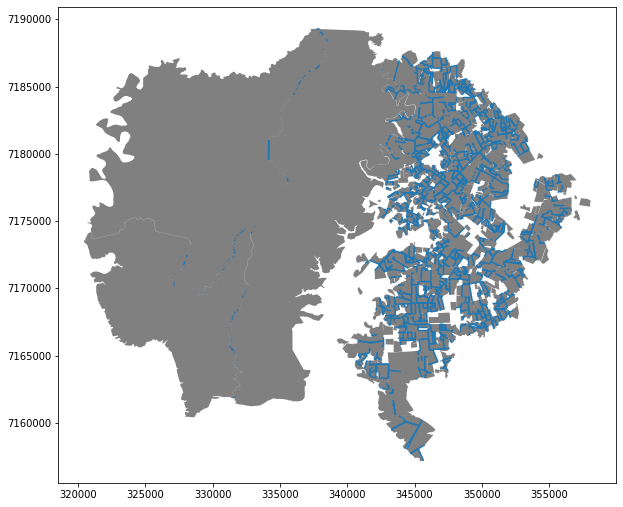

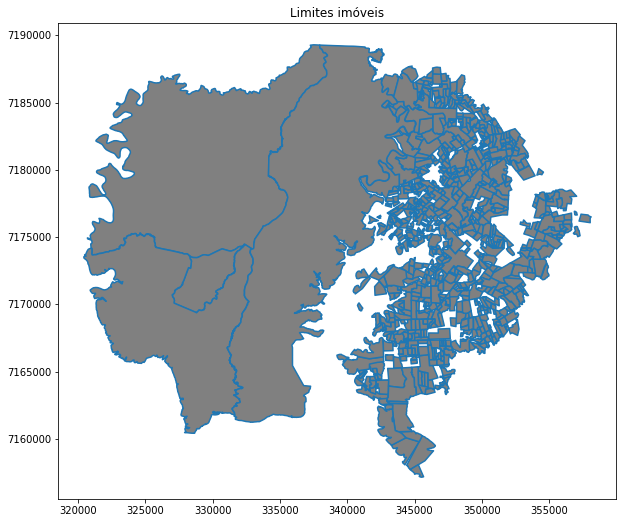

In [126]:
ax2 = difference.plot(ax=unionarea_im_gdf.plot(color='gray', figsize=(10, 10)), facecolor='blue');
#ax = difference.plot(figsize=(10,15));
ax.set_title("Diferença das áreas sobrepostas");
ax2 = im_overlap.plot(ax=unionarea_im_gdf.plot(color='gray', figsize=(10, 10)), facecolor='gray');
#ax2 = im_overlap.plot(figsize=(10,15));
ax2.set_title("Limites imóveis");

### Verificação das nascentes 

In [127]:
#Extraindo as nascentes da fundação dentro da área dos imóveis
nasc_fund_clip = nasc_fund[nasc_fund['geometry'].within(unionarea_im)]

In [128]:
#Nascente CAR
nasc_car = gpd.GeoDataFrame.from_file('NASCENTE_OLHO_DAGUA.shp')
nasc_car_reproj = nasc_car.to_crs({'init' :'epsg:31982'})

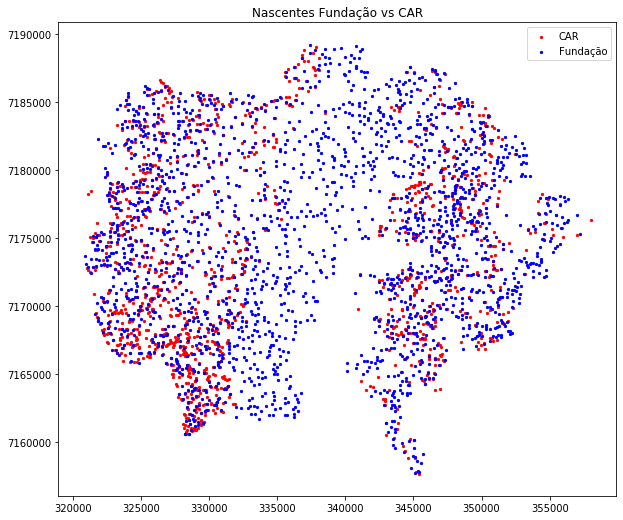

In [129]:
ay = nasc_fund_clip.plot(ax=nasc_car_reproj.plot(color='red', figsize=(10, 10), markersize=(5), label=u'CAR'), facecolor='Blue', markersize=(5), label ='Fundação');
ay.set_title("Nascentes Fundação vs CAR");
plt.legend(loc='best');

In [130]:
# Contabilizando o número de nascentes:
num_nasc_fund = len(nasc_fund_clip['geometry'])
num_nasc_car = len(nasc_car_reproj['geometry'])

#Número de nascentes da fundação:
print("Número nascente fundação: ",num_nasc_fund)

#Número de nascentes do CAR:
print("Número nascente CAR: ",num_nasc_car)

Número nascente fundação:  2042
Número nascente CAR:  1560


### Extração dos dados de App (Fundação)

In [131]:
#Extraindo as APP's da fundação dentro da área dos imóveis
App_fund_clip = app_fund['geometry'].intersection(unionarea_im)



In [132]:
#Transformando App_fund_clip em geodataframe para ser usada nas próximas análises
App_fund_clip_gdf = gpd.GeoDataFrame(gpd.GeoSeries(App_fund_clip))
App_fund_clip_gdf = App_fund_clip_gdf.rename(columns={0:'geometry'}).set_geometry('geometry')

In [133]:
#Projetando e salvando App_fund_clip_gdf em shapefile
App_fund_clip_gdf.crs = {'init' :'epsg:31982'}
App_fund_clip_gdf.crs
App_fund_clip_gdf.to_file('App_fund_clip.shp')

### Importando dados App CAR

In [134]:
# Replicar para os dados da App do Car
App_car = gpd.GeoDataFrame.from_file('APP.shp')
App_car.head()

,IDF,NOM_TEMA,NUM_AREA,geometry
0,20620,Ãrea de PreservaÃ§Ã£o Permanente de Rios atÃ©...,0.965031,(POLYGON ((-52.48070121940963 -25.461545856954...
1,142860,Ãrea de PreservaÃ§Ã£o Permanente de Rios atÃ©...,5.225999,(POLYGON ((-52.43137781982621 -25.504141902242...
2,142860,Entorno de ReservatÃ³rio para Abastecimento ou...,1.190323,POLYGON ((-52.43567696642957 -25.5073140083145...
3,149030,Ãrea de PreservaÃ§Ã£o Permanente de Rios atÃ©...,7.198648,(POLYGON ((-52.52854956757958 -25.603353839901...
4,149030,Ãrea de PreservaÃ§Ã£o Permanente de Nascentes...,0.700616,POLYGON ((-52.52548601553467 -25.6041469466298...


In [135]:
App_car_reproj = App_car.to_crs(31982)
App_car_reproj.crs = {'init' :'epsg:31982'}

In [136]:
# Função pra retornar o sistema de coordenada
App_car_reproj.crs

{'init': 'epsg:31982'}

In [137]:
#Para saber os tipos de APP
lista = list(App_car_reproj['NOM_TEMA'])
lista

['Ã\x81rea de PreservaÃ§Ã£o Permanente de Rios atÃ© 10 metros',
 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Rios atÃ© 10 metros',
 'Entorno de ReservatÃ³rio para Abastecimento ou GeraÃ§Ã£o de Energia',
 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Rios atÃ© 10 metros',
 "Ã\x81rea de PreservaÃ§Ã£o Permanente de Nascentes ou Olhos D'Ã¡gua Perenes",
 'APP segundo art. 61-A da Lei 12.651 de 2012',
 "Ã\x81rea de PreservaÃ§Ã£o Permanente de Nascentes ou Olhos D'Ã¡gua Perenes",
 'Ã\x81rea de PreservaÃ§Ã£o Permanente a Recompor de Rios atÃ© 10 metros',
 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Lagos e Lagoas Naturais',
 'Ã\x81rea de PreservaÃ§Ã£o Permanente de ReservatÃ³rio artificial decorrente de barramento de cursos dâ\x80',
 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Rios atÃ© 10 metros',
 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Rios atÃ© 10 metros',
 'Ã\x81rea de PreservaÃ§Ã£o Permanente a Recompor de Rios atÃ© 10 metros',
 'APP segundo art. 61-A da Lei 12.651 de 2012',
 'Ã\x81rea de PreservaÃ§Ã

In [138]:
#Adicionar os tipos desejados
rio_10 = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Rios atÃ© 10 metros']
rio_man = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Manguezais']
rio_nas = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Nascentes ou Olhos D\'Ã¡gua Perenes']
rio_per = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Lagos e Lagoas Naturais']
rio_ban = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Banhado']
rio_res = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de ReservatÃ³rio artificial decorrente de barramento de cursos dâ\x80']
rio_10_50 = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Rios de 10 atÃ© 50 metros']
rio_200_500 = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Rios de 200 atÃ© 600 metros']
rio_50_200 = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Rios de 50 atÃ© 200 metros']
rio_ver = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Ã\x81rea de PreservaÃ§Ã£o Permanente de Veredas']
rio_ener = App_car_reproj[App_car_reproj['NOM_TEMA'] == 'Entorno de ReservatÃ³rio para Abastecimento ou GeraÃ§Ã£o de Energia']

In [139]:
#Para concatenar topos os GeoDataFrames (tipos) escolhidos
app_car_new = gpd.GeoDataFrame(pd.concat([rio_10, rio_man, rio_nas, rio_per, rio_ban, rio_res, rio_10_50, rio_200_500, rio_50_200, rio_ver, rio_ener]))

In [140]:
app_car_new.head()

,IDF,NOM_TEMA,NUM_AREA,geometry
0,20620,Ãrea de PreservaÃ§Ã£o Permanente de Rios atÃ©...,0.965031,(POLYGON ((351135.3540935131 7183117.271952329...
1,142860,Ãrea de PreservaÃ§Ã£o Permanente de Rios atÃ©...,5.225999,(POLYGON ((356145.5463807079 7178453.624835208...
3,149030,Ãrea de PreservaÃ§Ã£o Permanente de Rios atÃ©...,7.198648,(POLYGON ((346504.7865077914 7167356.076692535...
10,149067,Ãrea de PreservaÃ§Ã£o Permanente de Rios atÃ©...,14.096845,(POLYGON ((348325.5796501563 7175659.054311993...
11,369594,Ãrea de PreservaÃ§Ã£o Permanente de Rios atÃ©...,2.137681,(POLYGON ((344323.9251417448 7177403.346057591...


In [141]:
app_car_new['geometry'] = app_car_new.buffer(0.01)

In [142]:
#Para fazer a união de todos os polígonos
app_car_casc = cascaded_union(app_car_new['geometry'])

In [143]:
app_car_casc

In [144]:
type(app_car_casc)

shapely.geometry.multipolygon.MultiPolygon

In [145]:
#1º passo para transformar a lista em GDF
app_car_casc_gdf = gpd.GeoDataFrame(gpd.GeoSeries(app_car_casc))

In [146]:
#2º passo para transformar a lista em GDF
app_car_casc_gdf = app_car_casc_gdf.rename(columns={0:'geometry'}).set_geometry('geometry')

In [147]:
#Colocar a projeção no novo GDF
app_car_casc_gdf.crs = {'init' :'epsg:31982'}
app_car_casc_gdf = app_car_casc_gdf.to_crs(31982)

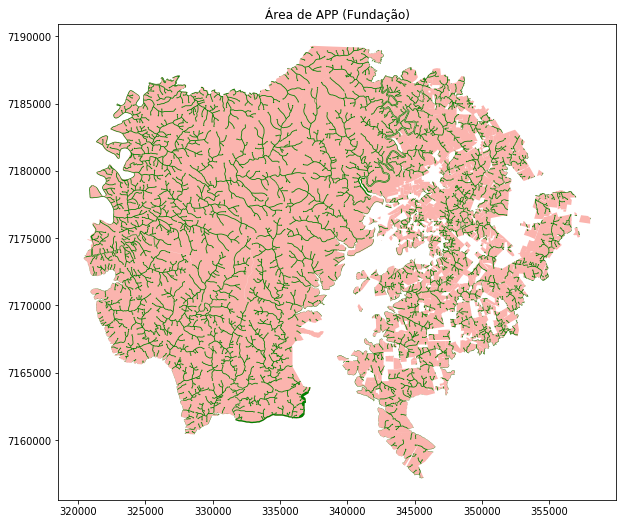

In [148]:
ay = App_fund_clip.plot(ax=unionarea_im_gdf.plot(cmap='Pastel1', figsize=(10, 10)), facecolor='green');
ay.set_title("Área de APP (Fundação)");



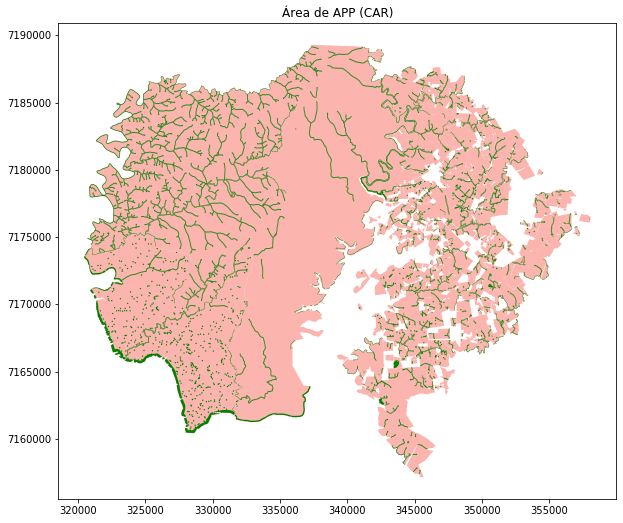

In [149]:
ay = app_car_casc_gdf.plot(ax=unionarea_im_gdf.plot(cmap='Pastel1', figsize=(10, 10)), facecolor='green');
ay.set_title("Área de APP (CAR)");


#### Diferença de área entre as APP's

In [151]:
print("Área APP fundação: ",sum(App_fund_clip_gdf.area/10000))
print("Área APP CAR: ",sum(app_car_casc_gdf.area/10000))

Área APP fundação:  9474.549351363952
Área APP CAR:  5459.481013118706


# Etapa 3 - Cálculo das áreas de APP, do CAR e da fundação, a serem recompostas, assim como da Reserva Legal 

In [ ]:
#Função para fazer a diferença entre os polígonos do CAR e os polígonos da vegetação nativa total
app_car_dif = app_car_casc.difference(vg_nat)
#app_car_dif = app_car_casc_gdf['geometry'].difference(vg_nat)

In [ ]:
#Função para fazer o intersection
new_app_fund_int = App_fund_clip_gdf['geometry'].difference(vg_nat)

In [ ]:
print(sum(app_car_dif.area))
print(sum(new_app_fund_int.area))

#### Área vegetadas de cada shape

In [ ]:
# Áreas vegetadas de APP

print("Área Diferença APP_fund e Veg Nativa: ", sum(new_app_fund_int.area/10000))
print("Área Diferença CAR e Veg Nativa: ", sum(app_car_dif/10000))

### Reserva Legal 

In [235]:
# Reserva legal CAR
Res_legal = gpd.GeoDataFrame.from_file('RESERVA_LEGAL.shp')
Res_legal.head()

,IDF,NOM_TEMA,NUM_AREA,geometry
0,20620,Reserva Legal Proposta,1.847480,(POLYGON ((-52.47838497161865 -25.464354415485...
1,142860,Reserva Legal Proposta,14.907881,(POLYGON ((-52.42410961269698 -25.506378705610...
2,149030,Reserva Legal Averbada,8.303572,(POLYGON ((-52.53155024547772 -25.605850228637...
3,149067,Reserva Legal Proposta,20.370975,(POLYGON ((-52.5105415460899 -25.5284704834466...
4,867089,Reserva Legal Proposta,1.438618,POLYGON ((-52.55951623286653 -25.5325664863190...


In [236]:
#Reprojetando 
Res_legal_reproj.crs = Res_legal.to_crs({'init' :'epsg:31982'})

In [17]:
Res_legal_reproj.crs

{'init': 'epsg:31982'}

In [246]:
#Fazer o buffer para evitar erros nos próximos procedimentos
Res_legal_reproj['geometry'] = Res_legal_reproj.buffer(0.001)

In [251]:
#Função para unir todos os polígonos que se tocam
res_legal_casc = Res_legal_reproj['geometry'].unary_union

In [252]:
#1º passo para transformar a lista em GDF
res_legal_casc_gdf = gpd.GeoDataFrame(gpd.GeoSeries(res_legal_casc))

In [253]:
#2º passo para transformar a lista em GDF
res_legal_casc_gdf = res_legal_casc_gdf.rename(columns={0:'geometry'}).set_geometry('geometry')

In [254]:
res_legal_casc_gdf.crs = {'init' :'epsg:31982'}
res_legal_casc_gdf = res_legal_casc_gdf.to_crs(31982)

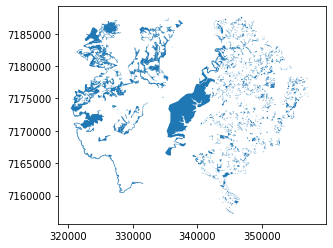

In [255]:
res_legal_casc_gdf.plot()

In [256]:
#Soma da área de reserva legal do CAR
sum(res_legal_casc_gdf.area)

116240250.5847486

In [260]:
#Fazer o buffer para evitar erros nos próximos procedimentos
res_legal_casc_gdf['geometry'] = res_legal_casc_gdf.buffer(0.01)

In [261]:
#Função para fazer a diferença entre os polígonos da reserva legal e os polígonos da vegetação nativa total
res_legal_dif = res_legal_casc_gdf['geometry'].difference(vg_nat)

In [262]:
#Cálculo da área a ser recomposta
sum(res_legal_dif.area)

21108369.238669064

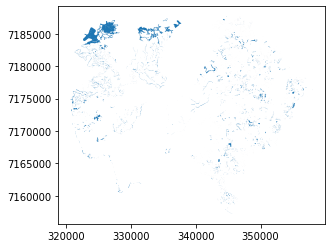

In [263]:
res_legal_dif.plot()